In [ ]:
import pandas as pd

df = pd.read_csv("lesiones.csv")

In [ ]:
df.head()

,id,n_victimas,aaaa,mm,dd,fecha,hora,franja_hora,direccion_normalizada,comuna,...,latutid,victima,acusado,participantes,moto,auto,transporte_publico,camion,ciclista,gravedad
0,LC-2019-0000179,1,2019,1,1,1/1/2019,9:00,9,SD,14,...,-34.559658,CICLISTA,SD,CICLISTA-SD,SD,SD,SD,SD,x,SD
1,LC-2019-0000053,1,2019,1,1,1/1/2019,1:55,1,SD,8,...,-34.669125,AUTO,SD,AUTO-SD,SD,x,SD,SD,SD,SD
2,LC-2019-0000063,1,2019,1,1,1/1/2019,2:00,2,SD,8,...,-34.677556,SD,SD,SD-SD,SD,SD,SD,SD,SD,SD
3,LC-2019-0000079,1,2019,1,1,1/1/2019,2:30,2,SD,7,...,-34.647349,PEATON,SD,PEATON-SD,x,SD,SD,SD,SD,SD
4,LC-2019-0000082,4,2019,1,1,1/1/2019,4:30,4,SD,3,...,-34.604579,AUTO,SD,AUTO-SD,SD,SD,x,SD,SD,SD


In [ ]:
df.columns

Index(['id', 'n_victimas', 'aaaa', 'mm', 'dd', 'fecha', 'hora', 'franja_hora',
       'direccion_normalizada', 'comuna', 'tipo_calle', 'otra_direccion',
       'calle', 'altura', 'cruce', 'geocodificacion_CABA', 'longitud',
       'latutid', 'victima', 'acusado', 'participantes', 'moto', 'auto',
       'transporte_publico', 'camion', 'ciclista', 'gravedad'],
      dtype='object')

In [ ]:
import plotly.express as px
import pandas as pd

df = pd.read_csv("lesiones.csv")
fig = px.scatter_geo(df, lat='latutid', lon='longitud', #color='mag',
                     hover_name='calle', #size='mag',
                     title='Siniestros en caba')
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.update_layout(mapbox_bounds={"west": -180, "east": -50, "south": 20, "north": 90})
fig.show()

In [ ]:
import geopandas as gpd

rslt_df = df[df['longitud'] != 'SD']
rslt_df2 = rslt_df[rslt_df['latutid'] != 'SD']

print(len(rslt_df2))
rslt_df2[['longitud', 'latutid']]
rslt_df2.longitud.dtypes

rslt_df2['longitud'] = rslt_df2['longitud'].astype("string")
rslt_df2['latutid'] = rslt_df2['latutid'].astype("string")

rslt_df2['geocodificacion_CABA']

22576


0        Point (104991.46333918849995825 107720.9664748...
1        Point (101813.84712503915943671 95578.55507230...
2        Point (99538.58660300650808495 94643.418717990...
3        Point (102372.16830963784013875 97994.13750300...
4        Point (105968.98286849579017144 102737.1734686...
                               ...                        
23780            Point (95400.5441905024 96621.6007711877)
23781            Point (97705.4491469278 98614.8825470092)
23782    Point (107377.10694920316745993 105120.7873965...
23783            Point (104472.702045632 101660.930364258)
23784    Point (114990.04979284359433223 88934.67755418...
Name: geocodificacion_CABA, Length: 22576, dtype: object

TypeError: float() argument must be a string or a real number, not 'NAType'

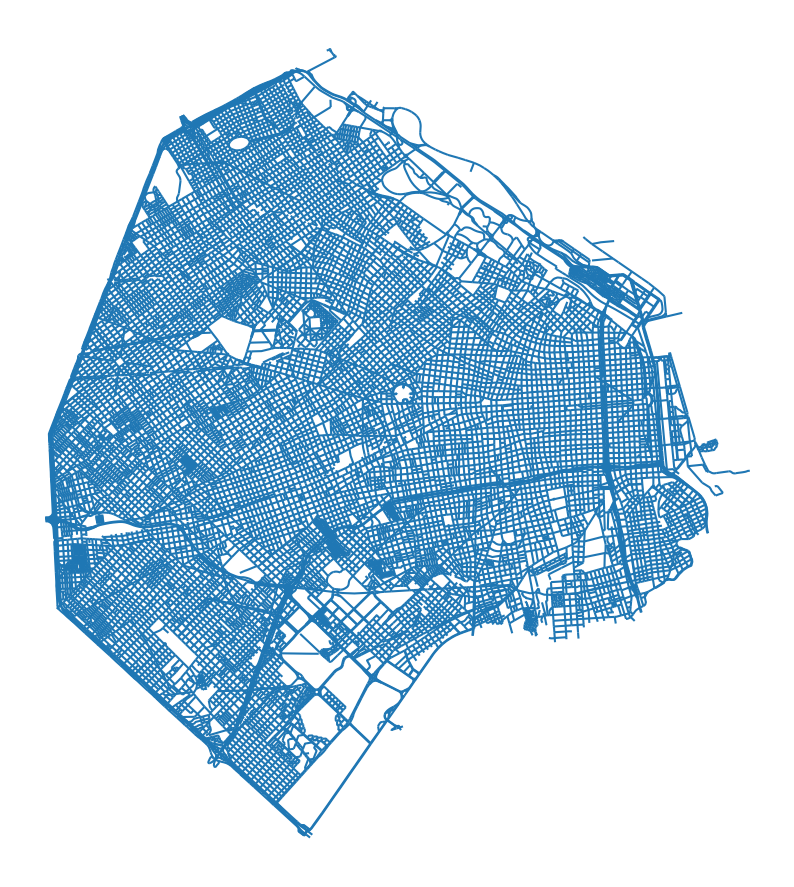

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import os
import shapefile

encodings = ['utf-8', 'ISO8859-1']

# Import all roads NL
map_df = gpd.read_file('callejero.shp', encoding='ISO8859-1')

# Show data format
map_df.head()

# Set image properties
fig, ax = plt.subplots(1, figsize=(10,14))
map_df.plot(ax=ax)
ax.axis('off')

# Set coordinates to match Utrecht, change for your own city
ax.set_aspect('equal')

points = gpd.points_from_xy(rslt_df2['longitud'], rslt_df2['latutid'])

baseball = gpd.GeoDataFrame(rslt_df2, geometry = points, crs='EPSG:4326')

baseball.plot()

# Plot the street map of Utrecht
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv('lesiones.csv')

# Rename the 'latutid' column to 'latitude'
df.rename(columns={'latutid': 'latitude'}, inplace=True)

# Convert 'longitud' and 'latitude' columns to numeric, coercing errors to NaN
df['longitud'] = pd.to_numeric(df['longitud'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')

# Display any rows where conversion failed
conversion_errors = df[df['longitud'].isna() | df['latitude'].isna()]
print(conversion_errors)


                    id  n_victimas  aaaa  mm  dd       fecha   hora  \
19     LC-2019-0000928           1  2019   1   2    1/2/2019   7:01   
33     LC-2019-0022496           1  2019   1   2    1/2/2019  10:00   
72     LC-2019-0007634           1  2019   1   4    1/4/2019  14:50   
79     LC-2019-0008283           2  2019   1   4    1/4/2019  17:53   
93     LC-2019-0008974           1  2019   1   5    1/5/2019   9:30   
...                ...         ...   ...  ..  ..         ...    ...   
23642  LC-2021-0640811           1  2021  12  23  12/23/2021  18:00   
23669  LC-2021-0641851           1  2021  12  25  12/25/2021   0:00   
23740  LC-2021-0649774           1  2021  12  29  12/29/2021   0:00   
23772  LC-2021-0652278           1  2021  12  31  12/31/2021   8:25   
23784  LC-2020-0244615           1  2020   5  17   5/17/2020  21:00   

      franja_hora direccion_normalizada           comuna  ... latitude  \
19              7                    SD                5  ...      NaN   

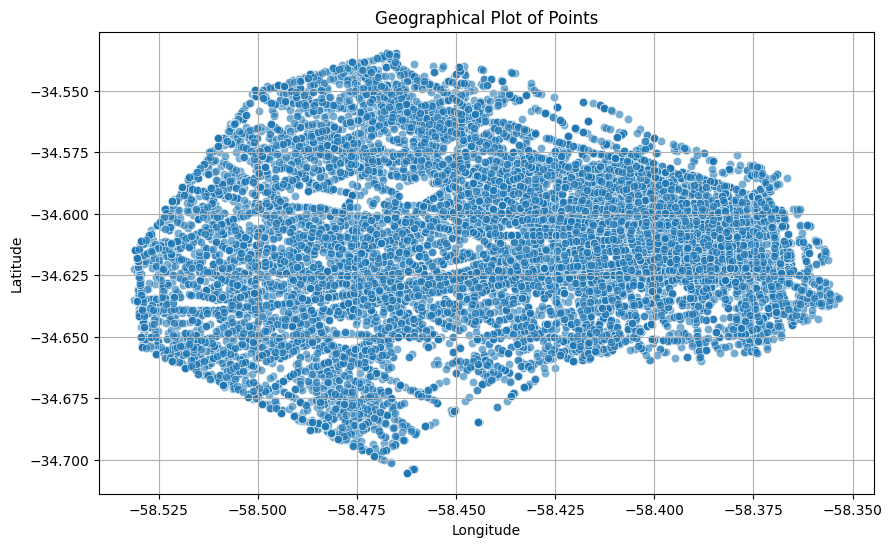

In [ ]:
# Drop rows with NaN values in 'longitud' or 'latitude'
df.dropna(subset=['longitud', 'latitude'], inplace=True)

# Plot the points
plt.figure(figsize=(10, 6))
plt.scatter(df['longitud'], df['latitude'], alpha=0.6, edgecolors='w', linewidth=0.5)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Geographical Plot of Points')
plt.grid(True)
plt.show()


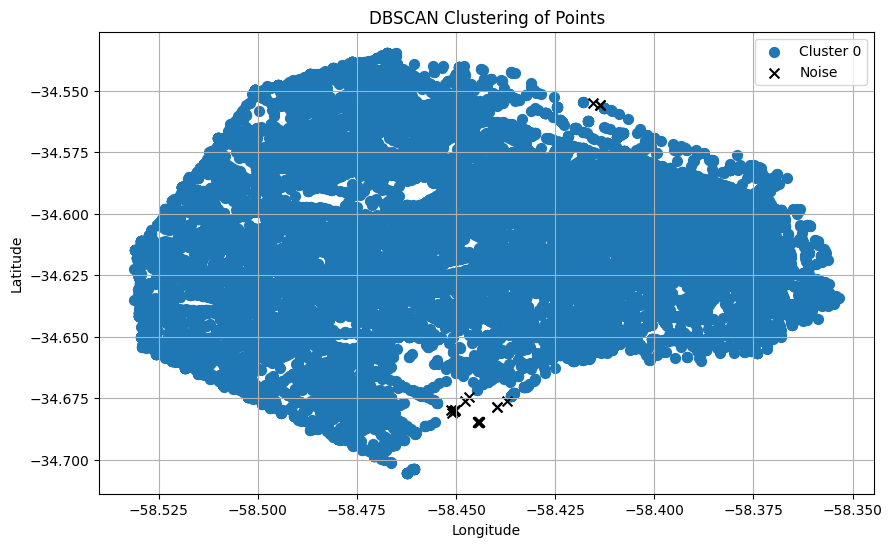

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Load the CSV file
df = pd.read_csv('lesiones.csv')

# Rename the 'latutid' column to 'latitude'
df.rename(columns={'latutid': 'latitude'}, inplace=True)

# Convert 'longitud' and 'latitude' columns to numeric, coercing errors to NaN
df['longitud'] = pd.to_numeric(df['longitud'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')

# Drop rows with NaN values in 'longitud' or 'latitude'
df.dropna(subset=['longitud', 'latitude'], inplace=True)

# Prepare the data for DBSCAN
coords = df[['latitude', 'longitud']].values
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(coords)

# Apply DBSCAN
db = DBSCAN(eps=0.2, min_samples=50).fit(coords_scaled)
labels = db.labels_

# Add cluster labels to the dataframe
df['cluster'] = labels

# Plot the results
plt.figure(figsize=(10, 6))
unique_labels = set(labels)
for label in unique_labels:
    class_member_mask = (labels == label)
    xy = df[class_member_mask]
    if label == -1:  # Noise
        plt.scatter(xy['longitud'], xy['latitude'], s=50, c='k', marker='x', label='Noise')
    else:
        plt.scatter(xy['longitud'], xy['latitude'], s=50, marker='o', label=f'Cluster {label}')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('DBSCAN Clustering of Points')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
import pandas as pd
import folium

# Load the CSV file
df = pd.read_csv('lesiones.csv')

# Rename the 'latutid' column to 'latitude'
df.rename(columns={'latutid': 'latitude'}, inplace=True)

# Convert 'longitud' and 'latitude' columns to numeric, coercing errors to NaN
df['longitud'] = pd.to_numeric(df['longitud'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')

# Drop rows with NaN values in 'longitud' or 'latitude'
df.dropna(subset=['longitud', 'latitude'], inplace=True)

# Create a Folium map centered on Buenos Aires
map_center = [-34.603722, -58.381592]  # Coordinates of Buenos Aires
m = folium.Map(location=map_center, zoom_start=12)

# Add points to the map
for idx, row in df.iterrows():
    folium.CircleMarker(
        location=(row['latitude'], row['longitud']),
        radius=1,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.2
    ).add_to(m)

# Save the map to an HTML file
m.save('buenos_aires_points.html')

# Display the map in the notebook (if running in a Jupyter environment)
m


In [ ]:
import pandas as pd
import folium
from folium.plugins import HeatMap

# Load the CSV file
df = pd.read_csv('lesiones.csv')

# Rename the 'latutid' column to 'latitude'
df.rename(columns={'latutid': 'latitude'}, inplace=True)

# Convert 'longitud' and 'latitude' columns to numeric, coercing errors to NaN
df['longitud'] = pd.to_numeric(df['longitud'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')

# Drop rows with NaN values in 'longitud' or 'latitude'
df.dropna(subset=['longitud', 'latitude'], inplace=True)

# Create a Folium map centered on Buenos Aires
map_center = [-34.603722, -58.381592]  # Coordinates of Buenos Aires
m = folium.Map(location=map_center, zoom_start=12)

# Prepare data for HeatMap
heat_data = [[row['latitude'], row['longitud']] for index, row in df.iterrows()]

# Add HeatMap to the map
HeatMap(heat_data, radius=10).add_to(m)

# Save the map to an HTML file
m.save('buenos_aires_heatmap.html')

# Display the map in the notebook (if running in a Jupyter environment)
m


In [ ]:
pip install geohash2

  Preparing metadata (setup.py) ... done
  Created wheel for geohash2: filename=geohash2-1.1-py3-none-any.whl size=15544 sha256=8db42b2817f8332412e5544a6865d1d1520f487dba205cc8a0c442089c792b85
  Stored in directory: /root/.cache/pip/wheels/c0/21/8d/fe65503f4f439aef35193e5ec10a14adc945e20ff87eb35895
Successfully built geohash2


In [ ]:
pip install polygon_geohasher

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Created wheel for polygon_geohasher: filename=polygon_geohasher-0.0.1-py3-none-any.whl size=4127 sha256=ba4298e71a3c634f1532352f9cf0ad1ac18d8d945a2b60315dafa5b5c2eab2fd
  Stored in directory: /root/.cache/pip/wheels/7a/2c/0c/b9f07e44718d72ab291eb717f3277ae3872925740d18828e10
  Created wheel for python-geohash: filename=python_geohash-0.8.5-cp310-cp310-linux_x86_64.whl size=41536 sha256=faaf9afac1dc6bc5f4707da0ca99b4dfba9c2c595cc352c85a3869cb49d4d3d9
  Stored in directory: /root/.cache/pip/wheels/19/e8/74/3f800ffdbb57c27a3fee3a695c7009769356448837c1f4f899
Successfully built polygon_geohasher python-geohash


In [ ]:
import pandas as pd
import geohash2
import geohash
import folium
from folium.plugins import HeatMap
from polygon_geohasher.polygon_geohasher import geohashes_to_polygon

def get_geohash_bounds(geohash_code):
    lat1, lon1, lat2, lon2 = geohash.bbox(geohash_code).values()
    return [(lat1, lon1), (lat1, lon2), (lat2, lon2), (lat2, lon1), (lat1, lon1)]


# Load the CSV file
df = pd.read_csv('lesiones.csv')
#df = df.loc[df['aaaa'] == 2021]

# Rename the 'latutid' column to 'latitude'
df.rename(columns={'latutid': 'latitude'}, inplace=True)

# Convert 'longitud' and 'latitude' columns to numeric, coercing errors to NaN
df['longitud'] = pd.to_numeric(df['longitud'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')

# Drop rows with NaN values in 'longitud' or 'latitude'
df.dropna(subset=['longitud', 'latitude'], inplace=True)

# Define a function to convert latitude and longitude to geohash
def to_geohash(row, precision=7):
    return geohash2.encode(row['latitude'], row['longitud'], precision=precision)

# Apply the function to create a geohash column
df['geohash'] = df.apply(to_geohash, axis=1)

# Count the number of accidents in each geohash zone
geohash_counts = df['geohash'].value_counts().reset_index()
geohash_counts.columns = ['geohash', 'count']
geohash_counts['bounds'] = geohash_counts['geohash'].apply(get_geohash_bounds)
# Create a Folium map centered on Buenos Aires
map_center = [-34.603722, -58.381592]  # Coordinates of Buenos Aires
m = folium.Map(location=map_center, zoom_start=12)

# Add geohash zones to the map with the counts
for idx, row in geohash_counts.iterrows():
    # Decode the geohash to get the center of the zone
    lat, lon = geohash2.decode(row['geohash'])
    count = row['count']


#    polygon = geohashes_to_polygon(row['geohash'])

    if count >= 5:
      # Add a marker for the geohash zone
      folium.Polygon(locations=row['bounds'],
                     color='green',
                     fill=True,
                     fill_color='green',
                     fill_opacity=0.5,
                    popup=f'Geohash: {row["geohash"]}, Count: {count}').add_to(m)

      folium.CircleMarker(
          location=(lat, lon),
          radius=1 + count * 0.5,  # Adjust radius based on count
          color='blue',
          fill=True,
          fill_color='blue',
          fill_opacity=0.6,
          popup=f'Geohash: {row["geohash"]}, Count: {count}'
      ).add_to(m)

# Save the map to an HTML file
m.save('buenos_aires_geohash_map.html')

# Display the map in the notebook (if running in a Jupyter environment)
m


In [ ]:
df = pd.read_csv('lesiones.csv')
df = df.loc[df['aaaa'] == 2021]
df.head()

,id,n_victimas,aaaa,mm,dd,fecha,hora,franja_hora,direccion_normalizada,comuna,...,latutid,victima,acusado,participantes,moto,auto,transporte_publico,camion,ciclista,gravedad
16058,LC-2021-0001328,1,2021,1,2,1/2/2021,10:45,10,SUPERI y AZURDUY JUANA,12,...,-34.556194114948,CICLISTA,AUTO,CICLISTA-AUTO,0,x,0,0,x,SD
16059,LC-2021-0001891,1,2021,1,3,1/3/2021,0:30,0,LADINES y SAN MARTIN AV.,11,...,-34.590359251363,CICLISTA,AUTO,CICLISTA-AUTO,0,x,0,0,x,SD
16060,LC-2021-0003171,1,2021,1,4,1/4/2021,7:59,7,SARANDI y MEXICO,3,...,-34.615889709630,CICLISTA,CAMIONETA,CICLISTA-CAMIONETA,0,0,0,x,x,SD
16061,LC-2021-0003610,1,2021,1,4,1/4/2021,13:14,13,BLANCO ENCALADA 5500,12,...,-34.578560837567,CICLISTA,AUTO,CICLISTA-AUTO,0,x,0,0,x,SD
16062,LC-2021-0004326,1,2021,1,4,1/4/2021,16:30,16,CERVIÃ‘O AV. y BULNES,14,...,-34.581181645129,CICLISTA,AUTO,CICLISTA-AUTO,0,x,0,0,x,SD


In [ ]:
import pandas as pd
import geohash
import folium

# Sample DataFrame with geohashes
data = {'geohash': ['ezs42', 'ezs43', 'ezs44']}
df = pd.DataFrame(data)

# Function to get the bounding box of a geohash
def get_geohash_bounds(geohash_code):
    lat1, lon1, lat2, lon2 = geohash.bbox(geohash_code).values()
    return [(lat1, lon1), (lat1, lon2), (lat2, lon2), (lat2, lon1), (lat1, lon1)]

# Get bounding box coordinates for each geohash
df['bounds'] = df['geohash'].apply(get_geohash_bounds)

# Create a Folium map centered around the average location
center_lat = sum([pt[0] for bound in df['bounds'] for pt in bound]) / (len(df) * 4)
center_lon = sum([pt[1] for bound in df['bounds'] for pt in bound]) / (len(df) * 4)
mymap = folium.Map(location=[center_lat, center_lon], zoom_start=10)

# Add polygons for each geohash
for idx, row in df.iterrows():
    folium.Polygon(locations=row['bounds'], color='blue', fill=True, fill_color='blue', fill_opacity=0.0).add_to(mymap)

# Save the map to an HTML file
mymap.save('geohash_areas_map.html')

# Display the map in a Jupyter notebook (optional)
mymap


In [ ]:
import pandas as pd
import geohash2
import geohash
import folium
from folium.plugins import HeatMap
from polygon_geohasher.polygon_geohasher import geohashes_to_polygon

def get_geohash_bounds(geohash_code):
    lat1, lon1, lat2, lon2 = geohash.bbox(geohash_code).values()
    return [(lat1, lon1), (lat1, lon2), (lat2, lon2), (lat2, lon1), (lat1, lon1)]


# Load the CSV file
df = pd.read_csv('homicidios.csv')
#df = df.loc[df['aaaa'] == 2021]

# Rename the 'latutid' column to 'latitude'
df.rename(columns={'pos x': 'longitud'}, inplace=True)
df.rename(columns={'pos y': 'latitude'}, inplace=True)

# Convert 'longitud' and 'latitude' columns to numeric, coercing errors to NaN
df['longitud'] = pd.to_numeric(df['longitud'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')

# Drop rows with NaN values in 'longitud' or 'latitude'
df.dropna(subset=['longitud', 'latitude'], inplace=True)

# Define a function to convert latitude and longitude to geohash
def to_geohash(row, precision=8):
    return geohash2.encode(row['latitude'], row['longitud'], precision=precision)

# Apply the function to create a geohash column
df['geohash'] = df.apply(to_geohash, axis=1)

# Count the number of accidents in each geohash zone
geohash_counts = df['geohash'].value_counts().reset_index()
geohash_counts.columns = ['geohash', 'count']
geohash_counts['bounds'] = geohash_counts['geohash'].apply(get_geohash_bounds)
# Create a Folium map centered on Buenos Aires
map_center = [-34.603722, -58.381592]  # Coordinates of Buenos Aires
m = folium.Map(location=map_center, zoom_start=12)

# Add geohash zones to the map with the counts
for idx, row in geohash_counts.iterrows():
    # Decode the geohash to get the center of the zone
    lat, lon = geohash2.decode(row['geohash'])
    count = row['count']


#    polygon = geohashes_to_polygon(row['geohash'])

    # Add a marker for the geohash zone
    folium.Polygon(locations=row['bounds'],
                    color='green',
                    fill=True,
                    fill_color='green',
                    fill_opacity=0.5,
                  popup=f'Geohash: {row["geohash"]}, Count: {count}').add_to(m)

    folium.CircleMarker(
        location=(lat, lon),
        radius=1 + count * 0.5,  # Adjust radius based on count
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=f'Geohash: {row["geohash"]}, Count: {count}'
    ).add_to(m)

# Save the map to an HTML file
m.save('buenos_aires_geohash_map.html')

# Display the map in the notebook (if running in a Jupyter environment)

print(df)
m

            ID  N_VICTIMAS       FECHA  AAAA  MM  DD      HORA  HH  \
0    2016-0001           1    1/1/2016  2016   1   1   4:00:00   4   
1    2016-0002           1    1/2/2016  2016   1   2   1:15:00   1   
2    2016-0003           1    1/3/2016  2016   1   3   7:00:00   7   
3    2016-0004           1   1/10/2016  2016   1  10   0:00:00   0   
4    2016-0005           1   1/21/2016  2016   1  21   5:20:00   5   
..         ...         ...         ...   ...  ..  ..       ...  ..   
691  2021-0093           1  12/13/2021  2021  12  13  17:10:00  17   
692  2021-0094           1  12/20/2021  2021  12  20   1:10:00   1   
693  2021-0095           1  12/30/2021  2021  12  30   0:43:00   0   
694  2021-0096           1  12/15/2021  2021  12  15  10:30:00  10   
695  2021-0097           1  11/18/2021  2021  11  18   6:10:00   6   

                               LUGAR_DEL_HECHO TIPO_DE_CALLE  ...  \
0    AV PIEDRA BUENA Y AV FERNANDEZ DE LA CRUZ       AVENIDA  ...   
1            AV GRAL 